# Cosmos-UK soil moisture

:::{eval-rst}
:opticon:`tag`
:badge:`Agriculture,badge-primary`
:badge:`Sensors,badge-secondary`
:::

## Context
### Purpose
To load and visualise daily hydrometeorological and soil data from the [2013-2019 public COSMOS-UK dataset](https://catalogue.ceh.ac.uk/documents/b5c190e4-e35d-40ea-8fbe-598da03a1185).

### Sensor description
Since 2013 the UK Centre for Ecology & Hydrology (UKCEH) has established the world’s most spatially dense national network of cosmic-ray neutron sensors (CRNSs) to monitor soil moisture across the UK. The Cosmic-ray Soil Moisture Observing System for the UK (COSMOS-UK) delivers field-scale soil water volumetric content (VWC) for around 50 sites in  near-real time. Additional to inform near-surface soil moisture, the network collects a large number of hydrometeorological and soil data variables, including VWC measured by point-scale soil moisture sensors, to support hydrological and land surface modelling and monitoring applications across science and industry. 

This notebook explores a subset of 4 out of 51 stations available in the public COSMOS-UK dataset. These stations represent the first sites to prototype COSMOS sensors in the UK, see further details in Evans *et al.* (2016) and they are situated in human-intervened areas (grassland and cropland), except for one in a woodland land cover site.

The UKCEH media below summarises the concept of cosmic-ray neutron sensors and how they provide non-invasive soil moisture measurments at field scale. 

<iframe width="560" height="315" src="https://www.youtube.com/embed/3roY_cHsn9c" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

### Highlights
* Fetch COSMOS-UK dataset files through `intake`.
* Inspect the available metadata with information about the sites, their locations and other site-specific attributes.
* Explore relationships between daily mean soil moisture and daily total evapotranspiration.
* Analyse yearly change of daily mean soil moisture.
* Compare field-scale CRNSs and point-scale soil moisture measurements at daily resolution.


### Contributions

#### Notebook
* Alejandro Coca-Castro (author), Alan Turing Institute, [@acocac](https://github.com/acocac)
* Doran Khamis (reviewer), UK Centre for Ecology & Hydrology, [@dorankhamis](https://github.com/dorankhamis)
* Matt Fry (reviewer), UK Centre for Ecology & Hydrology, [@mattfry-ceh](https://github.com/mattfry-ceh)

#### Dataset originator/creator
* UK Centre for Ecology & Hydrology (creator)
* Natural Environment Research Council (support)

#### Dataset authors
* Stanley, S.; Antoniou, V.; Askquith-Ellis, A.; Ball, L.A.; Bennett, E.S.; Blake, J.R.; Boorman, D.B.; Brooks, M.; Clarke, M.; Cooper, H.M.; Cowan, N.; Cumming, A.; Evans, J.G.; Farrand, P.; Fry, M.; Hitt, O.E.; Lord, W.D.; Morrison, R.; Nash, G.V.; Rylett, D.; Scarlett, P.M.; Swain, O.D.; Szczykulska, M.; Thornton, J.L.; Trill, E.J.; Warwick, A.C.; Winterbourn, B. 

#### Dataset documentation
```{bibliography}
  :style: plain
  :list: bullet
  :filter: topic % "agriculture-sensors-cosmosuk"
```

:::{note}
Data from COSMOS-UK up to the end of 2019 are available for download from the UKCEH Environmental Information Data Centre (EIDC). The data are accompanied by documentation that describes the site-specific instrumentation, data and processing including quality control. The dataset is available under the terms of the Open Government Licence. 

COSMOS-UK work was supported by the Natural Environment Research Council award number NE/R016429/1 as part of the UK-SCAPE programme delivering National Capability.
:::

## Load libraries

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
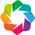

In [1]:
import os
import pandas as pd
import intake
import holoviews as hv
import panel as pn
import matplotlib.pyplot as plt
from bokeh.models.formatters import DatetimeTickFormatter
from datetime import datetime

import hvplot.pandas
import hvplot.xarray  # noqa

import warnings
warnings.filterwarnings(action='ignore')

pd.options.display.max_columns = 10
hv.extension('bokeh')
pn.extension()

## Set project structure

In [2]:
notebook_folder = '../sensors/agriculture-sensors-cosmosuk'
if not os.path.exists(notebook_folder):
    os.makedirs(notebook_folder)

## Load data
Load an intake catalog for the downloaded data

In [3]:
# set catalogue location
catalog_file = os.path.join(notebook_folder, 'catalog.yaml')

with open(catalog_file, 'w') as f:
    f.write('''
sources:
  data_siteid:
    driver: csv
    parameters:
      stationid:
        description: five letter code for the COSMOS-UK site
        type: str
        default: CHIMN
      resolution:
        description: temporal resolution
        type: str
        default: Daily
        allowed:
          - Daily
          - Hourly
          - SH
    args:
      urlpath: "{{ CATALOG_DIR }}/data/COSMOS-UK_HydroSoil_{{resolution}}_2013-2019/COSMOS-UK_{{stationid}}_HydroSoil_{{resolution}}_2013-2019.csv"
      csv_kwargs:
        assume_missing: true
        na_values: [-9999]
        parse_dates: ['DATE_TIME']
      storage_options: {'anon': True}

  data_all:
    driver: csv
    parameters:
      resolution:
        description: temporal resolution
        type: str
        default: Daily
        allowed:
          - Daily
          - Hourly
          - SH
    args:
      urlpath: "{{ CATALOG_DIR }}/data/COSMOS-UK_HydroSoil_{{resolution}}_2013-2019/COSMOS-UK_*.csv"
      csv_kwargs:
        assume_missing: true
        na_values: [-9999]
        parse_dates: ['DATE_TIME']
      storage_options: {'anon': True}

  metadata_sites:
    driver: csv
    args:
      urlpath: "{{ CATALOG_DIR }}/data/COSMOS-UK_SiteMetadata_2013-2019.csv"
      csv_kwargs:
        header: 0
        parse_dates: [ 'START_DATE','END_DATE']
      storage_options: {'anon': True}

  metadata_measurements:
    driver: csv
    parameters:
      resolution:
        description: temporal resolution
        type: str
        default: Daily
        allowed:
          - Daily
          - Hourly
          - SH
    args:
      urlpath: "{{ CATALOG_DIR }}/data/COSMOS-UK_HydroSoil_{{resolution}}_2013-2019_Metadata.csv"
      csv_kwargs:
        header: 0
      storage_options: {'anon': True}

  location:
    driver: intake_xarray.image.ImageSource
    parameters:
      stationid:
        description: five letter code for the COSMOS-UK site
        type: str
        default: CHIMN
    args:
      urlpath: "https://eip.ceh.ac.uk/hydrodata/cosmos-uk/maps/airphoto/1000px/{{stationid}}.jpg"
    
''')

In [4]:
cat = intake.open_catalog(catalog_file)

## Load metadata

Here we load COSMOS-UK metadata into memory. The metadata contains multiple columns about the sites, their locations and other site-specific attributes.

In [5]:
metadata = cat.metadata_sites().read()
print(metadata.columns.tolist())

['SITE_NAME', 'SITE_ID', 'START_DATE', 'END_DATE', 'EASTING', 'NORTHING', 'EAST_NORTH_EPSG', 'LATITUDE', 'LONGITUDE', 'LAT_LONG_ESPG', 'ALTITUDE', 'SOIL_TYPE', 'LAND_COVER', 'BULK_DENSITY', 'BULK_DENSITY_SD', 'SOIL_ORGANIC_CARBON', 'SOIL_ORGANIC_CARBON_SD', 'LATTICE_WATER', 'LATTICE_WATER_SD']


In [6]:
metadata

,SITE_NAME,SITE_ID,START_DATE,END_DATE,EASTING,...,BULK_DENSITY_SD,SOIL_ORGANIC_CARBON,SOIL_ORGANIC_CARBON_SD,LATTICE_WATER,LATTICE_WATER_SD
0,Chimney Meadows,CHIMN,2013-10-02,NaT,436113,...,0.095,0.027,0.0016,0.011,0.0018
1,Sheepdrove,SHEEP,2013-10-24,NaT,436039,...,0.140,0.059,0.0086,0.027,0.0060
2,Waddesdon,WADDN,2013-11-04,NaT,472548,...,0.160,0.034,0.0023,0.021,0.0021
3,Wytham Woods,WYTH1,2013-11-26,2016-10-01,445738,...,0.190,0.028,0.0044,0.017,0.0047


For this example, we will explore a subset of four stations, all of them with start date in 2013. Only the Wytham Woods station ceased on 10th January 2016. This station is situated in a Broadleaf woodland land cover which also hosts Environmental Change Network (ECN) and FLUXNET monitoring sites (see further details [here](https://cosmos.ceh.ac.uk/sites/WYTH1)). The dataframe contains each site name, id and corresponding land cover. CHIMN and WADDN are located situated in improved grassland, and SHEEP is in arable and horticulture. 

In [7]:
metadata[['SITE_NAME','SITE_ID','LAND_COVER']]

,SITE_NAME,SITE_ID,LAND_COVER
0,Chimney Meadows,CHIMN,Improved grassland
1,Sheepdrove,SHEEP,Arable and horticulture (previously improved g...
2,Waddesdon,WADDN,Improved grassland
3,Wytham Woods,WYTH1,Broadleaf woodland


A key feature of COSMOS-UK stations is their capability of monitoring field-scale soil moisture. The CRNSs VWC value is an average soil moisture measurement (%) across  an  estimated,  variable  footprint  of  radius up  to  200 m  and  estimated  variable  measurement  depth  ofbetween  approximately  0.1  and  0.8 m. Let's explore the notional footprint of the analysed stations from the CEH COSMOS-UK website. 

In [8]:
# set sliders
station_list = list(metadata.SITE_ID.tolist())

target_station = pn.widgets.Select(name = 'Station', options = station_list)

@pn.depends(target_station.param.value)
def plot_footprint(station):
    location_da = cat.location(stationid=station).to_dask()
    p = location_da.hvplot.rgb(x='x', y='y', bands='channel', data_aspect=1, flip_yaxis=True, xaxis=False, yaxis=None, hover=False)
    return p

plot_ie = pn.Row(
    plot_footprint,
    pn.Column(pn.Spacer(height=5), target_station, background='#f0f0f0', sizing_mode="fixed"),
    width_policy='max', height_policy='max',
)

plot_ie.embed()

## Load daily data

Here we load COSMOS-UK daily data into memory. The daily data is the level with the highest processing and derived from subhourly data. Note only certain variables are provided at this level.

In [9]:
site_daily_all = cat.data_all(resolution='Daily').read()
print(site_daily_all.columns.tolist())

['DATE_TIME', 'SITE_ID', 'COSMOS_VWC', 'D86_75M', 'SWE', 'SNOW', 'ALBEDO', 'PE']


To further understand the meaning of above columns, the COSMOS-UK dataset include a separate metadata file by time resolution. Let's explore the metadata for daily measurements. The dataframe below includes further details of each variable, including the unit, aggregation and data type. For instance, soil moisture measurements at daily resolution refer to the daily mean derived from CRNSs.

In [10]:
metadata_daily = cat.metadata_measurements(resolution='Daily').read()
metadata_daily

,VARIABLE_ID,VARIABLE_NAME,RESOLUTION,UNIT,AGGREGATION,DATA_TYPE
0,PE,Potential evapotranspiration,1 Day,mm,Daily total,Derived
1,COSMOS_VWC,Soil moisture (CRNS VWC),1 Day,%,Daily mean,Derived
2,D86_75M,Effective depth of CRNS (D86 at 75m),1 Day,cm,Daily mean,Derived
3,SWE,Snow water equivalent (from CRNS),1 Day,mm,Value at midday,Derived
4,ALBEDO,Albedo,1 Day,UNITLESS,Mean between 10:00 and 14:00,Derived
5,SNOW,Snow days,1 Day,UNITLESS,Daily value,Derived


### Timeseries

The plot below shows two timeseries, soil moisture and potential evapotranspiration (PE), provided by the daily COSMOS-UK dataset. PE refers to the potential evaporation from soils plus transpiration by plants and is strongly influenced by the available soil moisture. We evidence this relationship in the daily aggregated data of both variables as it is shown in the plot below. We also note each station has a different time span with the SITE_ID equal to WYTH1 containing the shortest records.

In [11]:
# set sliders
station_list = list(metadata.SITE_ID.tolist())

target_station = pn.widgets.Select(name = 'Station', options = station_list)

# set formater for dates
formatter = DatetimeTickFormatter(months='%b %Y')

@pn.depends(target_station.param.value)
def plot_pe_vwc(station):
    daily_dataset = cat.data_siteid(resolution='Daily', stationid=station).read()
    daily_dataset.dropna(subset = ['COSMOS_VWC','PE'], inplace=True) #remove empty rows
    
    p1=daily_dataset.hvplot(x='DATE_TIME', y=['COSMOS_VWC'], xformatter=formatter, xlabel = 'Date', ylabel = 'Volumetric Water Content (%)', color='blue', title='Soil Moisture (CRNS VWC)', line_width=0.8, fontscale=1.2, padding=0.2)
    p2=daily_dataset.hvplot(x='DATE_TIME', y=['PE'], xformatter=formatter, xlabel = 'Date', ylabel = 'Potential Evapotranspiration (mm)', color='red', title='Potential Evapotranspiration (1 day)', line_width=0.8, fontscale=1.2, padding=0.2)

    return (p1 + p2).cols(1)

plot_ie = pn.Row(
    plot_pe_vwc,
    pn.Column(pn.Spacer(height=5), target_station, background='#f0f0f0', sizing_mode="fixed"),
    width_policy='max', height_policy='max',
)

plot_ie.embed()

### Correlation

To explore further the close relationship between above variables and their seasonal dynamics, let's generate correlation charts grouped by season. The highest values of PE are in the summer followed by spring, fall and winter. The forest site, WYTH1, has higher soil moisture values than the human-intervened places, CHIMN and WADDN (improved grassland), and SHEEP (arable and horticulture site).

In [12]:
def season(df):
    """Add season column based on lat and month
    """
    seasons = {3: 'spring',  4: 'spring',  5: 'spring',
                   6: 'summer',  7: 'summer',  8: 'summer',
                   9: 'fall',   10: 'fall',   11: 'fall',
                  12: 'winter',  1: 'winter',  2: 'winter'}
    return df.assign(season=df.DATE_TIME.dt.month.map(seasons))

site_daily_all = season(site_daily_all)

custom_dict = {'winter': 0, 'spring': 1, 'summer': 3, 'fall':4}
plot_ie = site_daily_all.sort_values('season', key=lambda x: x.map(custom_dict)).hvplot.scatter(x='COSMOS_VWC', y='PE',
    row='season', col='SITE_ID', alpha=0.2, ylabel='PE (mm)', xlabel='VWC (%)',
    fontsize = {'title': 15, 'xticks': 9, 'yticks': 9, 'labels':11}, shared_axes=True                                                                                 
)
plot_ie

:GridSpace   [season,SITE_ID]
   :Scatter   [COSMOS_VWC]   (PE)

### Heatmap

The heatmap below allow us to discover temporal patterns from daily means of soil moisture. We observe 2018 contains the lowest consecutive values of VWC.

In [13]:
plot_ie = site_daily_all.hvplot.heatmap(
    x='DATE_TIME',
    y='SITE_ID',
    C='COSMOS_VWC',
    xformatter=formatter,
    title='Time series of CRNS soil moisture',
    cmap='RdYlBu',
    width=600,
    height=300,
    xlabel='',
    ylabel='Site ID',
    fontsize = {'title': 15, 'xticks': 12, 'yticks': 15}
)
plot_ie

:HeatMap   [DATE_TIME,SITE_ID]   (COSMOS_VWC)

## Load sub-hourly

The subhourly data contains all preprocessed weather and soil variables, except CRNSs. Let's explore the columns of the subhourly datasets of one of the stations, SHEEP.

In [14]:
subhourly_dataset = cat.data_siteid(resolution='SH', stationid='SHEEP').read()
print(subhourly_dataset.columns.tolist())

['DATE_TIME', 'SITE_ID', 'LWIN', 'LWOUT', 'SWIN', 'SWOUT', 'RN', 'PRECIP', 'PA', 'TA', 'WS', 'WD', 'Q', 'RH', 'SNOWD_DISTANCE_COR', 'UX', 'UY', 'UZ', 'G1', 'G2', 'TDT1_TSOIL', 'TDT1_VWC', 'TDT2_TSOIL', 'TDT2_VWC', 'TDT3_TSOIL', 'TDT3_VWC', 'TDT4_TSOIL', 'TDT4_VWC', 'TDT5_TSOIL', 'TDT5_VWC', 'TDT6_TSOIL', 'TDT6_VWC', 'TDT7_TSOIL', 'TDT7_VWC', 'TDT8_TSOIL', 'TDT8_VWC', 'TDT9_TSOIL', 'TDT9_VWC', 'TDT10_TSOIL', 'TDT10_VWC', 'STP_TSOIL2', 'STP_TSOIL5', 'STP_TSOIL10', 'STP_TSOIL20', 'STP_TSOIL50']


Similar to the daily observation, the metadata file for subhourly resolution informs variable long names, their resolution, units, aggregation details and data types. In this case, most of the variables are measured. For soil moisture, the measurements provided are by time domain transmissometry (TDT) sensors. These sensors measure point-based soil moisture at different depths as it commonly conducted in soil moisture in-situ sensing.

In [15]:
metadata_subhourly = cat.metadata_measurements(resolution='SH').read()
metadata_subhourly

,VARIABLE_ID,VARIABLE_NAME,RESOLUTION,UNIT,AGGREGATION,DATA_TYPE
0,G1,Soil heat flux 1,30 Minute,Wm-2,Mean over preceding 30 mins,Measured
1,G2,Soil heat flux 2,30 Minute,Wm-2,Mean over preceding 30 mins,Measured
2,LWIN,Incoming longwave radiation,30 Minute,Wm-2,Mean over preceding 30 mins,Measured
3,LWOUT,Outgoing longwave radiation,30 Minute,Wm-2,Mean over preceding 30 mins,Measured
4,PA,Atmospheric pressure,30 Minute,hPa,Mean over preceding 30 mins,Measured
5,PRECIP,Precipitation,30 Minute,mm,Total over preceding 30 mins,Measured
6,Q,Absolute humidity,30 Minute,gm-3,Mean over preceding 30 mins,Derived
7,RH,Relative humidity,30 Minute,%,Mean over preceding 30 mins,Measured
8,RN,Net radiation,30 Minute,Wm-2,Mean over preceding 30 mins,Derived
9,SNOWD_DISTANCE_COR,Snow depth,30 Minute,mm,Instantaneous,Measured


### Comparison of soil moisture probes

We can compare CNRSs and TDT soil moisture measurements at daily resolution. This procedure requires to resample TDT measurements from subhourly to daily. The cell below defines a function to resample and join daily CNRS and resampled TDT. The function yields an interactive `hvplot` by station ID from the merged observations.

In [16]:
@pn.depends(target_station.param.value)
def site_daily(target_station):
    """Timeseries plot showing the mean carbon flux at each DOY as well as the min and max"""

    # subhourly
    daily_dataset = cat.data_siteid(resolution='Daily', stationid=target_station).read()
    daily_dataset.index = daily_dataset.DATE_TIME.astype('datetime64[ns]')

    subhourly_dataset = cat.data_siteid(resolution='SH', stationid=target_station).read()

    target_columns = subhourly_dataset.columns.str.endswith('_VWC')

    daily_aggregate = subhourly_dataset.groupby(subhourly_dataset['DATE_TIME'].dt.date, as_index=True)[subhourly_dataset.columns[subhourly_dataset.columns.str.endswith('_VWC')]].mean()
    daily_aggregate.index = daily_aggregate.index.astype('datetime64[ns]')

    daily_joined = daily_dataset.join(daily_aggregate)
    target_columns = subhourly_dataset.columns[subhourly_dataset.columns.str.endswith('_VWC')].tolist() + ['COSMOS_VWC']
    daily_joined = daily_joined[target_columns]
    daily_joined = daily_joined.reset_index()
    daily_joined.index = daily_joined.DATE_TIME.astype('datetime64[ns]')
    daily_joined.dropna(axis=1, how='all', inplace=True)

    daily_joined_long = pd.melt(daily_joined, id_vars='DATE_TIME',
                     var_name="Sensor", value_name="VWC")

    plot_daily = daily_joined_long.hvplot(x='DATE_TIME', y='VWC', by='Sensor',
                            xformatter=formatter,
                            label='Variation in VWC by sensor type',
                            ylabel='Volumetric Water Content (%)',
                            xlabel='Time', xlim=(datetime(2014,1,1), datetime(2019,12,31)))

    return plot_daily.opts(legend_position='top', **settings_lineplots)

settings_lineplots = dict(padding=0.1, height=400, width=700, fontsize={'title': '120%','labels': '120%', 'ticks': '100%'})

plot_ie = pn.Row(
    site_daily,
    pn.Column(pn.Spacer(height=5), target_station, background='#f0f0f0', sizing_mode="fixed"),
    width_policy='max', height_policy='max',
)

plot_ie.embed()

We conclude all sites contain at least two TDT probes, and their temporal sequence follow a similar pattern as the CRNS. It is worth mentioning the pattern might differ when we explore other stations in the full COSMOS-UK dataset which can contain more than two TDT probes.

## Summary

This notebook has demonstrated the use of certain open-source python packages to explore the 2013-2019 COSMOS-UK dataset:

* `intake` to easily fetch and manipulate daily and subhourly data, their metadata and other data types (remote images).
* `hvplot` to propose some interactive visualisations of hydrometeorological and soil data.
* `pandas` to resample subhourly data and merge them into a daily dataset of soil moisture.

## Additional information
**Dataset**: 2013-2019 COSMOS-UK dataset (further details of the version [here](https://catalogue.ceh.ac.uk/documents/b5c190e4-e35d-40ea-8fbe-598da03a1185)).

**License**: The code in this notebook is licensed under the MIT License. The Environmental Data Science book is licensed under the Creative Commons by Attribution 4.0 license. See further details [here](https://github.com/alan-turing-institute/environmental-ds-book/blob/master/LICENSE.md).

**Contact**: If you have any suggestion or report an issue with this notebook, feel free to [create an issue](https://github.com/alan-turing-institute/environmental-ds-book/issues/new/choose) or send a direct message to [environmental.ds.book@gmail.com](mailto:environmental.ds.book@gmail.com).

In [17]:
from datetime import date
print(f'Last tested: {date.today()}')

Last tested: 2022-03-29
